# RP-CSSP Project

In [1]:
import pandas as pd
from transformers import pipeline
from scipy.stats import chi2_contingency
import seaborn as sns
from scipy.stats import ttest_ind
import numpy as np
from matplotlib import pyplot as plt
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, cohen_kappa_score
from sklearn.preprocessing import MinMaxScaler
import scipy.stats as stats
import json
from tqdm import tqdm
import plotly.express as px

In [2]:
data = pd.read_csv('C:/Users/Andri/Downloads/all_comments_sample_137K.csv')
# data = pd.read_csv('C:/Users/Andri/Downloads/all_comments/all_comments.csv')
print(len(data))
print(len(data.drop_duplicates('id')))

137555
137029


In [3]:
data.columns

Index(['id', 'body', 'subreddit', 'to_type', 'NEL', 'Names', 'created_utc',
       'sex', 'ethnicity', 'origin', 'DOB', 'highest_position', 'party',
       'entity_given_name', 'entity_family_name', 'given_name_used',
       'family_name_used', 'full_name_used', 'nickname_used', 'Adjectives',
       'Verbs', 'Nouns', 'Descriptors_parsed', 'Verbs_parsed', 'Relation',
       'Valence', 'Arousal', 'Dominance'],
      dtype='object')

## LEIA

In [4]:
# run LEIA analysis
sample = data.copy()

pipe = pipeline(model="LEIA/LEIA-base", tokenizer="LEIA/LEIA-base", truncation=True, device = 0)

def leia_analyzer(inputs):
    out = pipe(inputs)[0]
    sentiment = str.lower(out['label'])
    prob = out['score']
    return [sentiment, prob]

# Emotion mapping

emo_map = {'sadness' : {'valence' : [-0.63, 0.23], 'arousal' : [-0.27, 0.34], 'dominance' : [-0.33, 0.22]},
          'fear' : {'valence' : [-0.64, 0.2], 'arousal' : [0.60, 0.32], 'dominance' : [-0.43, 0.30]},
          'anger' : {'valence' : [-0.51, 0.20], 'arousal' : [0.59, 0.33], 'dominance' : [0.25, 0.39]},
          'joy' : {'valence' : [0.76, 0.22], 'arousal' : [0.48, 26], 'dominance' : [0.35, 31]}, # joy is actually not part of LEIAs output
          'affection' : {'valence' : [0.64, 0.26], 'arousal' : [0.35, 0.34], 'dominance' : [0.24, 0.4]},
          'happiness' : {'valence' : [0.81, 0.21], 'arousal' : [0.51, 0.26], 'dominance' : [0.46, 0.38]}}

In [5]:
# sample['leia'] = sample['body'].map(leia_analyzer)
# sample['sentiment'] = sample['leia'].map(lambda x: x[0])
# sample['sentiment_prob'] = sample['leia'].map(lambda x: x[1])

# sample = pd.read_csv('leia_to_vad_sample_137k.csv')

# sample['valence'] = sample['sentiment'].map(emo_map).apply(lambda x: x['valence'][0])
# sample['arousal'] = sample['sentiment'].map(emo_map).apply(lambda x: x['arousal'][0])
# sample['dominance'] = sample['sentiment'].map(emo_map).apply(lambda x: x['dominance'][0])

# sample['nd_valence'] = sample['sentiment'].map(emo_map).apply(lambda x: np.random.normal(x['valence'][0], x['valence'][1], 1)[0])
# sample['nd_arousal'] = sample['sentiment'].map(emo_map).apply(lambda x: np.random.normal(x['arousal'][0], x['arousal'][1], 1)[0])
# sample['nd_dominance'] = sample['sentiment'].map(emo_map).apply(lambda x: np.random.normal(x['dominance'][0], x['dominance'][1], 1)[0])
# sample.head()

# sample.to_csv('leia_to_vad_sample_137k.csv', index = False)

### Validation

In [6]:
# load LEIA data
sample = pd.read_csv('leia_to_vad_sample_137k.csv')
len(sample)

137555

In [7]:
# sample.sample(100, random_state = 42)[['id', 'body']].to_csv('validation_sample.csv', index = False, encoding = 'utf-8')

In [8]:
# manually label the sample with 1-6 (corresponding to affection, anger, etc.)
# manual_label = []

# for i in range(100):
#     manual_label.append(input(f'{i + 3}:')) # +3 so it matches the line number shown in excel...

In [9]:
# add manual labels validation sample
# val_sample = sample.sample(100, random_state = 42)
# val_sample['manual_label'] = manual_label
# val_sample['manual_label'] = pd.to_numeric(val_sample['manual_label'])

# mapping = {1 : 'affection', 2 : 'anger', 3 : 'fear', 4 : 'happiness', 5 : 'joy', 6 : 'sadness'}
# val_sample['manual_label'] = val_sample['manual_label'].map(mapping)

In [56]:
# save labeled val sample
# val_sample.to_csv('labeled_validation_sample.csv', index = False)

In [60]:
val_sample = pd.read_csv('labeled_validation_sample.csv')

# evaluate validation metrics

rev_mapping = {'affection' : 1, 'anger' : 2, 'fear' : 3, 'happiness' : 4, 'joy' : 5, 'sadness' : 6}

print('acc: ', accuracy_score(val_sample['manual_label'].map(rev_mapping), val_sample['sentiment'].map(rev_mapping)))
print('f1 weighted: ', f1_score(val_sample['manual_label'].map(rev_mapping), val_sample['sentiment'].map(rev_mapping), average = 'weighted'))
print('prec weighted: ', precision_score(val_sample['manual_label'].map(rev_mapping), val_sample['sentiment'].map(rev_mapping), average = 'weighted'))
print('rec weighted: ', recall_score(val_sample['manual_label'].map(rev_mapping), val_sample['sentiment'].map(rev_mapping), average = 'weighted'))
# print('kappa: ', cohen_kappa_score(val_sample['manual_label'].map(rev_mapping), val_sample['sentiment'].map(rev_mapping)))

acc:  0.61
f1 weighted:  0.5929424648577966
prec weighted:  0.6731916498993964
rec weighted:  0.61


sentiment
anger        0.789103
fear         0.128567
affection    0.046563
happiness    0.024630
sadness      0.011137
Name: count, dtype: float64
sentiment
anger        0.71
fear         0.14
affection    0.08
happiness    0.04
sadness      0.03
Name: count, dtype: float64


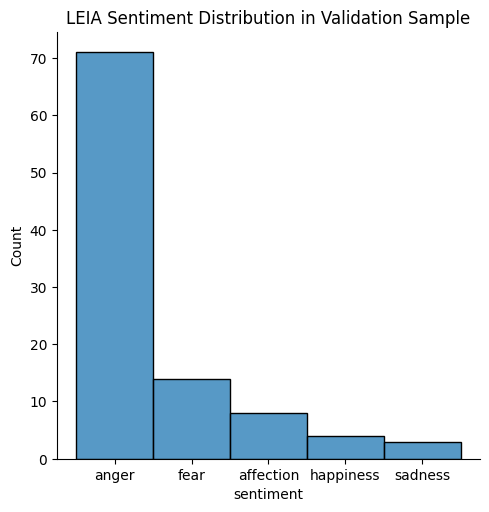

In [12]:
print(sample['sentiment'].value_counts() / len(sample))
print(val_sample['sentiment'].value_counts() / len(val_sample))

sns.displot(val_sample['sentiment'])
plt.title('LEIA Sentiment Distribution in Validation Sample')
plt.show()

***
## Analysis

#### Normalization (Rescale LEIA VADs to [0:1])

In [13]:
def normalize(data): # min/max normalization
    return (data - data.min()) / (data.max() - data.min())

In [14]:
# load LEIA data
sample = pd.read_csv('leia_to_vad_sample_137k.csv')

sample['valence'] = normalize(sample['valence'])
sample['arousal'] = normalize(sample['arousal'])
sample['dominance'] = normalize(sample['dominance'])

sample['nd_valence'] = normalize(sample['nd_valence'])
sample['nd_arousal'] = normalize(sample['nd_arousal'])
sample['nd_dominance'] = normalize(sample['nd_dominance'])

# sample.head(1)

In [15]:
# sample.to_csv('leia_vad_sample_normalized_137k.csv', index = False)

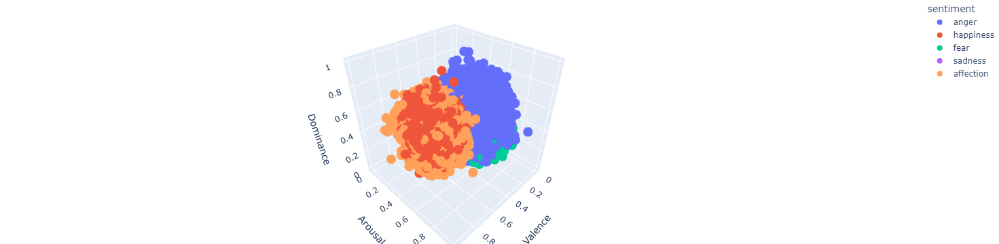

In [16]:
labels = {'nd_valence' : 'Valence', 'nd_arousal' : 'Arousal', 'nd_dominance' : 'Dominance'}
fig = px.scatter_3d(sample, x = 'nd_valence', y = 'nd_arousal', z = 'nd_dominance', color = 'sentiment', labels = labels)
fig.update_layout(margin = {'l' : 0, 'r' : 0, 'b' : 0, 't' : 0})
fig.show()

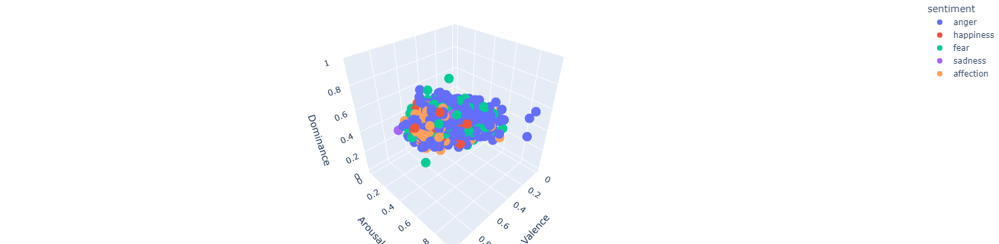

In [36]:
labels = {'nd_valence' : 'Valence', 'nd_arousal' : 'Arousal', 'nd_dominance' : 'Dominance'}
fig = px.scatter_3d(sample, x = 'Valence', y = 'Arousal', z = 'Dominance', color = 'sentiment', labels = labels)
fig.update_layout(margin = {'l' : 0, 'r' : 0, 'b' : 0, 't' : 0})
fig.show()

#### Bootstrapping setup (Viz is shown together with ttest results)

In [17]:
sample = pd.read_csv('leia_vad_sample_normalized_137k.csv')
sample.head(1)

,id,body,subreddit,to_type,NEL,Names,created_utc,sex,ethnicity,origin,...,Dominance,leia,sentiment,sentiment_prob,valence,arousal,dominance,nd_valence,nd_arousal,nd_dominance
0,e2r5x8o,"Paul Joseph Watson, Count Dankula and more ha...",The_Donald,t1,Q291169,['Jeremy Corbyn'],NaN,male,NaN,United Kingdom,...,0.563581,"['anger', 0.7147018909454346]",anger,0.714702,0.089655,0.988506,0.764045,0.304154,0.544277,0.402528


In [43]:
def bootstrap (data, n, og_vad_vars = ['Valence', 'Arousal', 'Dominance'], leia_vad_vars = ['nd_valence', 'nd_arousal', 'nd_dominance']):
    out = {'og_vad' : {'valence' : {'female' : {'ci_95' : None, 'bootstrap_dist' : []}, 'male' : {'ci_95' : None, 'bootstrap_dist' : []}},
                      'arousal' : {'female' : {'ci_95' : None, 'bootstrap_dist' : []}, 'male' : {'ci_95' : None, 'bootstrap_dist' : []}},
                      'dominance' : {'female' : {'ci_95' : None, 'bootstrap_dist' : []}, 'male' : {'ci_95' : None, 'bootstrap_dist' : []}}},
          'leia_vad' : {'valence' : {'female' : {'ci_95' : None, 'bootstrap_dist' : []}, 'male' : {'ci_95' : None, 'bootstrap_dist' : []}},
                      'arousal' : {'female' : {'ci_95' : None, 'bootstrap_dist' : []}, 'male' : {'ci_95' : None, 'bootstrap_dist' : []}},
                      'dominance' : {'female' : {'ci_95' : None, 'bootstrap_dist' : []}, 'male' : {'ci_95' : None, 'bootstrap_dist' : []}}}}
    
    for i in tqdm(range(n)):
        data = sample.sample(frac = 1, replace = True)
        female = data[data['sex'] == 'female']
        male = data[data['sex'] == 'male']
    
        for j, k in zip(['valence', 'arousal', 'dominance'], og_vad_vars):
            out['og_vad'][j]['female']['bootstrap_dist'].append(female[k].mean())
            out['og_vad'][j]['male']['bootstrap_dist'].append(male[k].mean())

        for j in ['female', 'male']:
            out['og_vad']['valence'][j]['ci_95'] = stats.norm.interval(0.95, loc=np.mean(out['og_vad']['valence'][j]['bootstrap_dist']), scale=np.std(out['og_vad']['valence'][j]['bootstrap_dist']))
            out['og_vad']['arousal'][j]['ci_95'] = stats.norm.interval(0.95, loc=np.mean(out['og_vad']['arousal'][j]['bootstrap_dist']), scale=np.std(out['og_vad']['arousal'][j]['bootstrap_dist']))
            out['og_vad']['dominance'][j]['ci_95'] = stats.norm.interval(0.95, loc=np.mean(out['og_vad']['dominance'][j]['bootstrap_dist']), scale=np.std(out['og_vad']['dominance'][j]['bootstrap_dist']))

        for j, k in zip(['valence', 'arousal', 'dominance'], leia_vad_vars):
            out['leia_vad'][j]['female']['bootstrap_dist'].append(female[k].mean())
            out['leia_vad'][j]['male']['bootstrap_dist'].append(male[k].mean())

        for j in ['female', 'male']:
            out['leia_vad']['valence'][j]['ci_95'] = stats.norm.interval(0.95, loc=np.mean(out['leia_vad']['valence'][j]['bootstrap_dist']), scale=np.std(out['leia_vad']['valence'][j]['bootstrap_dist']))
            out['leia_vad']['arousal'][j]['ci_95'] = stats.norm.interval(0.95, loc=np.mean(out['leia_vad']['arousal'][j]['bootstrap_dist']), scale=np.std(out['leia_vad']['arousal'][j]['bootstrap_dist']))
            out['leia_vad']['dominance'][j]['ci_95'] = stats.norm.interval(0.95, loc=np.mean(out['leia_vad']['dominance'][j]['bootstrap_dist']), scale=np.std(out['leia_vad']['dominance'][j]['bootstrap_dist']))

    return out

def draw(data, vad_metric, alpha = 0.7):
    fig, ax = plt.subplots(1, 2, sharey = True, figsize = (10, 6))
    
    ax[0].hist(data['og_vad'][vad_metric]['female']['bootstrap_dist'], alpha = alpha, label = 'female')
    ax[0].axvline(data['og_vad'][vad_metric]['female']['ci_95'][0], alpha = alpha*0.6, color = 'blue')
    ax[0].axvline(data['og_vad'][vad_metric]['female']['ci_95'][1], alpha = alpha*0.6, color = 'blue')
    nrc_female = data['og_vad'][vad_metric]['female']['ci_95']
    
    ax[0].hist(data['og_vad'][vad_metric]['male']['bootstrap_dist'], alpha = alpha, color = 'green', label = 'male')
    ax[0].axvline(data['og_vad'][vad_metric]['male']['ci_95'][0], alpha = alpha*0.6, color = 'green')
    ax[0].axvline(data['og_vad'][vad_metric]['male']['ci_95'][1], alpha = alpha*0.6, color = 'green')
    nrc_male = data['og_vad'][vad_metric]['male']['ci_95']
    
    ax[0].set_title('NRC VADs')
    ax[0].set_xlabel(f'Mean {vad_metric.title()}', x = 1.1)
    ax[0].set_ylabel('Count')

    ax[1].hist(data['leia_vad'][vad_metric]['female']['bootstrap_dist'], alpha = alpha, label = 'female')
    ax[1].axvline(data['leia_vad'][vad_metric]['female']['ci_95'][0], alpha = alpha*0.6, color = 'blue')
    ax[1].axvline(data['leia_vad'][vad_metric]['female']['ci_95'][1], alpha = alpha*0.6, color = 'blue')
    leia_female = data['leia_vad'][vad_metric]['female']['ci_95']

    ax[1].hist(data['leia_vad'][vad_metric]['male']['bootstrap_dist'], alpha = alpha, color = 'green', label = 'male')
    ax[1].axvline(data['leia_vad'][vad_metric]['male']['ci_95'][0], alpha = alpha*0.6, color = 'green')
    ax[1].axvline(data['leia_vad'][vad_metric]['male']['ci_95'][1], alpha = alpha*0.6, color = 'green')
    leia_male = data['leia_vad'][vad_metric]['male']['ci_95']

    ax[1].set_title('LEIA VADs')

    fig.suptitle(f'20k Bootstrap Results for {vad_metric.title()}')
    plt.legend()

    print(f'NRC VAD CIs: Female: {nrc_female}; Male: {nrc_male}')
    print(f'LEIA VAD CIs: Female: {leia_female}; Male: {leia_male}')
    plt.show()

In [19]:
# --> takes about 1,5 hours to rerun! <--
# vad_bootstraps = bootstrap(sample, n = 20000)

# with open('vad_bootstrap_results.json', 'w') as f:
#     json.dump(vad_bootstraps, f)

100%|██████████████████████████████████████████████████████████████████████████| 20000/20000 [1:25:55<00:00,  3.88it/s]


#### Parametric t-test (as in Marjanovic et al.) [Data is not normally distributed! RankSums might be a better choice]

In [19]:
with open('vad_bootstrap_results.json', 'r') as f:
    vad_bootstraps = json.load(f)

In [20]:
def cohend(d1, d2):
        # calculate the size of samples
        n1, n2 = len(d1), len(d2)
        # calculate the variance of the samples
        s1, s2 = np.var(d1, ddof=1), np.var(d2, ddof=1)
        # calculate the pooled standard deviation
        s = np.sqrt(((n1 - 1) * s1 + (n2 - 1) * s2) / (n1 + n2 - 2))
        # calculate the means of the samples
        u1, u2 = np.mean(d1), np.mean(d2)
        # calculate the effect size
        return (u1 - u2) / s

sample.drop_duplicates('id', inplace = True) # don't forget

fem = sample[sample['sex'] == 'female']
male = sample[sample['sex'] == 'male']

print(ttest_ind(fem['Valence'], male['Valence']))
print(ttest_ind(fem['nd_valence'], male['nd_valence']))
cohend(fem['nd_valence'], male['nd_valence'])

TtestResult(statistic=-3.9595164828403755, pvalue=7.513955508679265e-05, df=137020.0)
TtestResult(statistic=5.5610190720998025, pvalue=2.6870214101722652e-08, df=137020.0)


0.04464657842330323

NRC VAD CIs: Female: [0.3118551206851269, 0.31784030965067156]; Male: [0.3202142922701062, 0.32253509313967343]
LEIA VAD CIs: Female: [0.33733863152344007, 0.34122637411340034]; Male: [0.332965378883346, 0.33438544495138856]


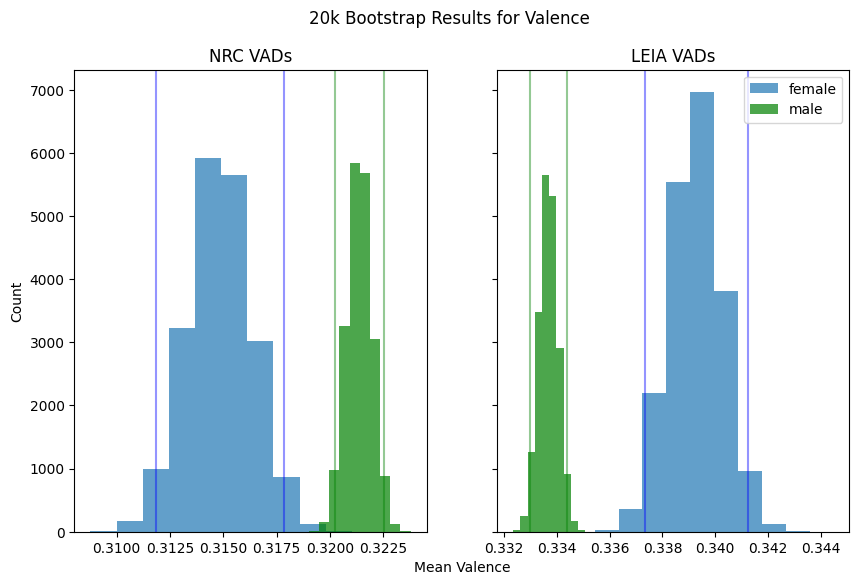

In [44]:
draw(vad_bootstraps, 'valence')

In [22]:
print(ttest_ind(fem['Arousal'], male['Arousal']))
print(ttest_ind(fem['nd_arousal'], male['nd_arousal']))
cohend(fem['nd_arousal'], male['nd_arousal'])

TtestResult(statistic=-6.060726574410119, pvalue=1.3585996864298e-09, df=137020.0)
TtestResult(statistic=-1.3334309053549556, pvalue=0.18239265264971827, df=137020.0)


-0.010705434870142779

NRC VAD CIs: Female: [0.241427054187256, 0.24607682884319712]; Male: [0.2506369927200524, 0.2524598984906909]
LEIA VAD CIs: Female: [0.5307211112675738, 0.5333803734774525]; Male: [0.5325321370157217, 0.5335505870600175]


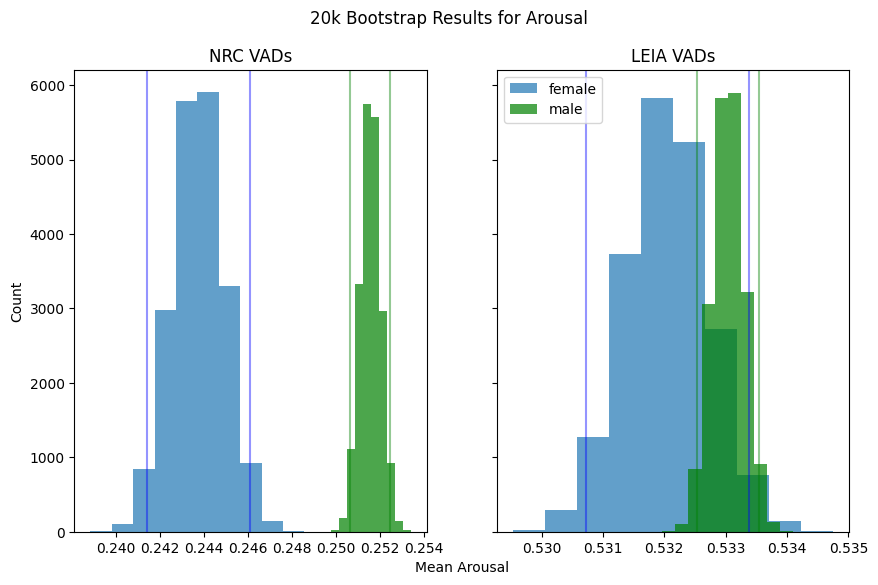

In [45]:
draw(vad_bootstraps, 'arousal')

In [24]:
print(ttest_ind(fem['Dominance'], male['Dominance']))
print(ttest_ind(fem['nd_dominance'], male['nd_dominance']))
cohend(fem['nd_dominance'], male['nd_dominance'])

TtestResult(statistic=-5.967594333567668, pvalue=2.4136578209477326e-09, df=137020.0)
TtestResult(statistic=1.437999265052472, pvalue=0.15043654648908636, df=137020.0)


0.01154496075762881

NRC VAD CIs: Female: [0.29011445553341225, 0.29566436826636416]; Male: [0.30097343134584104, 0.30314526908851175]
LEIA VAD CIs: Female: [0.4866327420367734, 0.4901873639933457]; Male: [0.48638935482511303, 0.48774829358956384]


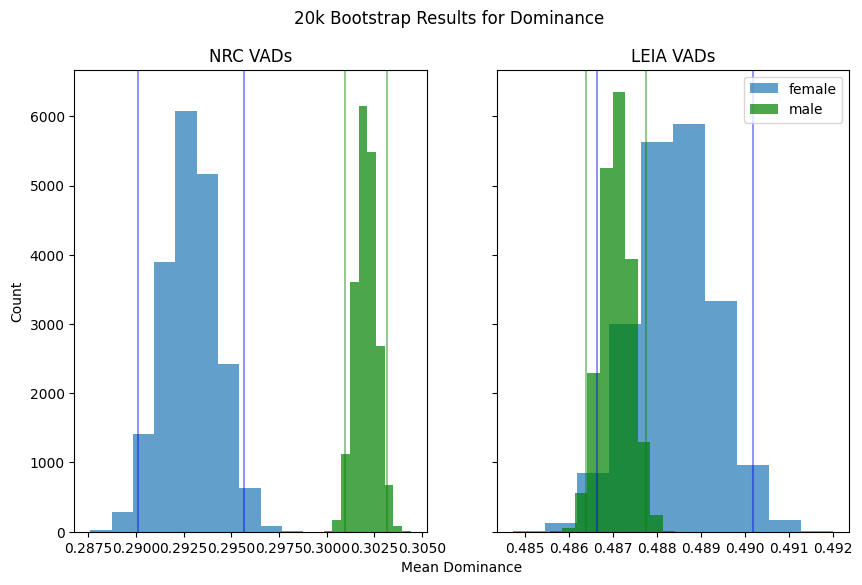

In [46]:
draw(vad_bootstraps, 'dominance')

#### Shapiro statistic (Assumption of normal distribution is violated)

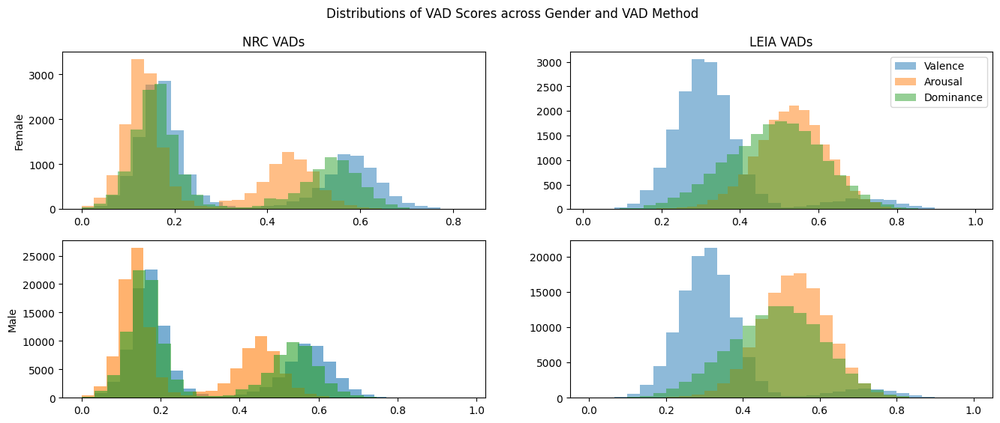

In [26]:
bins = 30
fig, ax = plt.subplots(2, 2, figsize = (16, 6))

ax[0][0].hist(fem['Valence'], alpha = 0.5, bins = bins)
ax[0][0].hist(fem['Arousal'], alpha = 0.5, bins = bins)
ax[0][0].hist(fem['Dominance'], alpha = 0.5, bins = bins)

ax[0][1].hist(fem['nd_valence'], alpha = 0.5, bins = bins, label = 'Valence')
ax[0][1].hist(fem['nd_arousal'], alpha = 0.5, bins = bins, label = 'Arousal')
ax[0][1].hist(fem['nd_dominance'], alpha = 0.5, bins = bins, label = 'Dominance')

ax[1][0].hist(male['Valence'], alpha = 0.6, bins = bins)
ax[1][0].hist(male['Arousal'], alpha = 0.6, bins = bins)
ax[1][0].hist(male['Dominance'], alpha = 0.6, bins = bins)

ax[1][1].hist(male['nd_valence'], alpha = 0.5, bins = bins)
ax[1][1].hist(male['nd_arousal'], alpha = 0.5, bins = bins)
ax[1][1].hist(male['nd_dominance'], alpha = 0.5, bins = bins)

ax[0][0].set(title = 'NRC VADs', ylabel = 'Female')
ax[0][1].set(title = 'LEIA VADs')
ax[1][0].set(ylabel = 'Male')
ax[0][1].legend()
fig.suptitle('Distributions of VAD Scores across Gender and VAD Method')
plt.show()

In [34]:
def statistic(x): # since the shapiro test's pvalue may be imprecise for N > 5000 I use the monte carlo test to get the p-value (recommended in the official doc of stats.shapiro)
    return stats.shapiro(x).statistic

# --> due to the monte carlo resampling this chunk takes about 20min to run! <--

print('OG VAD') # shapiro wilk statistic with monte carlo p <= 0.05 -> reject h0 that data is drawn form normal population
print('V:', stats.monte_carlo_test(sample['Valence'], stats.norm.rvs, statistic, alternative='less', batch = 1000))
print('A:', stats.monte_carlo_test(sample['Arousal'], stats.norm.rvs, statistic, alternative='less', batch = 1000))
print('D:', stats.monte_carlo_test(sample['Dominance'], stats.norm.rvs, statistic, alternative='less', batch = 1000))

print('\nLEIA Based VAD')
print('v:', stats.monte_carlo_test(sample['nd_valence'], stats.norm.rvs, statistic, alternative='less', batch = 1000))
print('a:', stats.monte_carlo_test(sample['nd_arousal'], stats.norm.rvs, statistic, alternative='less', batch = 1000))
print('d:', stats.monte_carlo_test(sample['nd_dominance'], stats.norm.rvs, statistic, alternative='less', batch = 1000))

OG VAD
V: MonteCarloTestResult(statistic=0.8207409439733633, pvalue=0.0001, null_distribution=array([0.99998929, 0.99997733, 0.99998526, ..., 0.99999028, 0.999989  ,
       0.99998884]))
A: MonteCarloTestResult(statistic=0.8355678177892781, pvalue=0.0001, null_distribution=array([0.99998615, 0.99998661, 0.9999864 , ..., 0.99998384, 0.99998638,
       0.99998199]))
D: MonteCarloTestResult(statistic=0.8274747830007744, pvalue=0.0001, null_distribution=array([0.99998305, 0.99998343, 0.99998584, ..., 0.99998758, 0.99998438,
       0.99998533]))

LEIA Based VAD
v: MonteCarloTestResult(statistic=0.8021367722246718, pvalue=0.0001, null_distribution=array([0.9999799 , 0.99997709, 0.99998299, ..., 0.99998574, 0.99998086,
       0.99997318]))
a: MonteCarloTestResult(statistic=0.9971426885042168, pvalue=0.0001, null_distribution=array([0.99998526, 0.99998256, 0.99998904, ..., 0.99997457, 0.99998685,
       0.99998791]))
d: MonteCarloTestResult(statistic=0.9983937884464168, pvalue=0.0001, null_dis

In [35]:
print('v:', stats.monte_carlo_test(sample['nd_valence'], stats.norm.rvs, statistic, alternative='less', batch = 1000))

AttributeError: module 'scipy.stats' has no attribute 'random'

#### Non-parametric Rank Sums Wilcoxon (Mann-Whitney U)

In [28]:
print(stats.ranksums(fem['Valence'], male['Valence'])) # OG vs.
print(stats.ranksums(fem['nd_valence'], male['nd_valence'])) # LEIA based VAD mapping

RanksumsResult(statistic=-3.880755343861437, pvalue=0.00010413255279090303)
RanksumsResult(statistic=3.208494104829234, pvalue=0.001334320446248393)


In [29]:
print(stats.ranksums(fem['Arousal'], male['Arousal']))
print(stats.ranksums(fem['nd_arousal'], male['nd_arousal']))

RanksumsResult(statistic=-7.174859791854465, pvalue=7.238132663048557e-13)
RanksumsResult(statistic=-1.1769915891546492, pvalue=0.2391988633312474)


In [30]:
print(stats.ranksums(fem['Dominance'], male['Dominance']))
print(stats.ranksums(fem['nd_dominance'], male['nd_dominance']))

RanksumsResult(statistic=-6.959163741937608, pvalue=3.4229848461923463e-12)
RanksumsResult(statistic=1.4630760202380593, pvalue=0.1434465786336926)


#### Non-parametric Chi² (sentiment and gender)

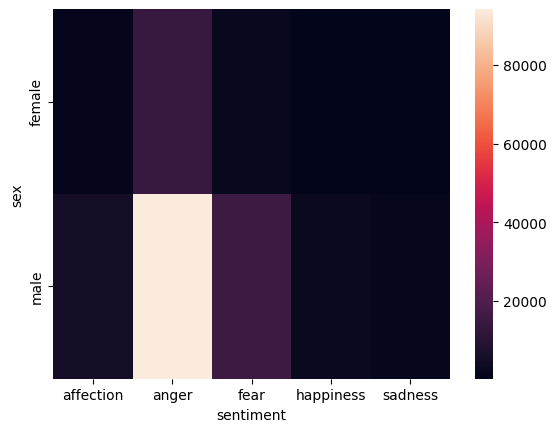

In [31]:
# calculate chi² using contingency table
conti = pd.crosstab(sample[sample['sex'].isin(['male', 'female'])]['sex'], sample['sentiment'])
sns.heatmap(conti)
plt.show()

In [32]:
chi2_contingency(conti)

Chi2ContingencyResult(statistic=47.71126290695936, pvalue=1.084065936483309e-09, dof=4, expected_freq=array([[  831.77913036, 14076.98314139,  2288.49904395,   439.4501321 ,
          199.2885522 ],
       [ 5558.22086964, 94067.01685861, 15292.50095605,  2936.5498679 ,
         1331.7114478 ]]))

# Additional Tables and Figures

In [198]:
sample[sample['id'].isin(val_sample['id'])][['id', 'sentiment', 'Valence', 'Arousal', 'Dominance', 'nd_valence', 'nd_arousal', 'nd_dominance']][-7:]

,id,sentiment,Valence,Arousal,Dominance,nd_valence,nd_arousal,nd_dominance
127382,f76aff9,fear,0.179638,0.132858,0.157276,0.235063,0.516702,0.348295
128712,fafp8xn,affection,0.267769,0.130692,0.208923,0.605192,0.374887,0.462084
128844,fbhfwsa,happiness,0.222412,0.155235,0.173824,0.721993,0.413671,0.610274
133466,fbkifyu,fear,0.162178,0.124044,0.141444,0.328853,0.487382,0.233346
133866,fbdesha,anger,0.151745,0.134800,0.174145,0.347222,0.552486,0.412906
134697,fc66m51,fear,0.140892,0.116291,0.134266,0.216650,0.461283,0.431268
137143,fai1h2t,anger,0.174803,0.154738,0.175639,0.431859,0.409522,0.298994


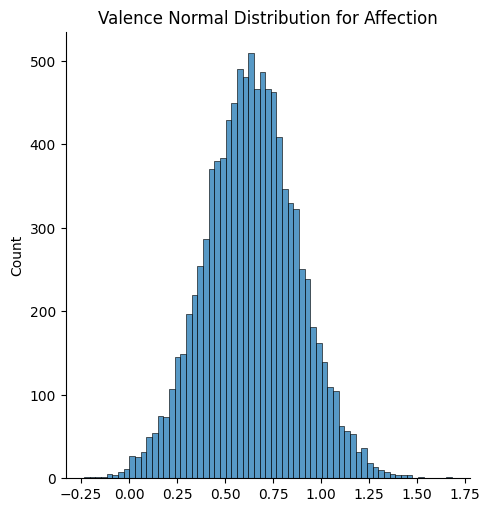

In [222]:
sns.displot(np.random.normal(0.64, 0.24, 10000))
plt.title('Valence Normal Distribution for Affection')
plt.show()

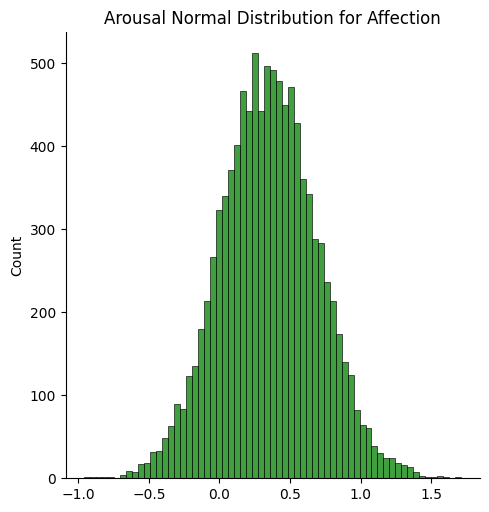

In [223]:
sns.displot(np.random.normal(0.35, 0.34, 10000), color = 'green')
plt.title('Arousal Normal Distribution for Affection')
plt.show()

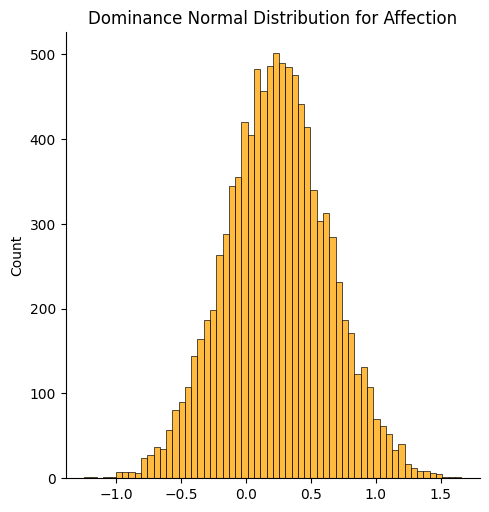

In [224]:
sns.displot(np.random.normal(0.24, 0.4, 10000), color = 'orange')
plt.title('Dominance Normal Distribution for Affection')
plt.show()

***
# Junkyard (Everything below was not used in the final project)
## ANEW
#### Data Prep for Analysis and Preprocessing

In [10]:
# create batches
sample_size_str = 'sample_part_3'
path = 'text_vad/inputs/'

sample = data[100000:][['id', 'body']]
sample.to_csv(f'{path}{sample_size_str}.csv', header = False, index = False)

# as txt file
with open(f'{path}{sample_size_str}.txt', "w", encoding='utf-8') as out:
    with open(f'{path}{sample_size_str}.csv', 'r', encoding='utf-8') as f:
        [out.write(": ".join(row) + '\n') for row in csv.reader(f)]

print(sample_size_str + ' saved!')

sample_part_3 saved!


In [117]:
# Combine ANEW dfs and pre-process

out_1 = pd.read_csv('text_vad/out/anew_mean/sample_part_1.csv', sep = ';')
out_2 = pd.read_csv('text_vad/out/anew_mean/sample_part_2.csv', sep = ';')
out_3 = pd.read_csv('text_vad/out/anew_mean/sample_part_3.csv', sep = ';')

out = pd.concat([out_1, out_2, out_3]).reset_index(drop = True)

out.drop_duplicates('Sentence', inplace = True) # some mess up with some of the texts due to parsing by the anew script probably
print(len(out))

out['id'] = out['Sentence'].apply(lambda x: x.strip('[]').replace("'", '').split(',')[0])

out.drop_duplicates('id', inplace = True)
print(len(out))

out = out[['id', 'Valence', 'Arousal', 'Dominance', 'Sentiment Label', 'Average VAD', '# Words Found', 'Found Words', 'All Words']]
out = out.rename(columns = {'Valence' : 'valence_anew', 'Arousal' : 'arousal_anew', 'Dominance' : 'dominance_anew', 'Sentiment Label' : 'sentiment_label',
'Average VAD' : 'average_vad_anew', '# Words Found' : '#_words_found', 'Found Words' : 'found_words', 'All Words' : 'all_words'})

out = out[out['id'].str.len() == 7].reset_index(drop = True) # drop cases that are not identifiable
out.reset_index(drop = True, inplace = True)

# out.to_csv('text_vad/out/anew_mean/all_comments_sample_137k_anew.csv', index = False)

137706
137117


#### ANEW Results and Analysis

In [5]:
anew_data = pd.read_csv('text_vad/out/anew_mean/all_comments_sample_137k_anew.csv')
data.drop_duplicates('id', inplace = True) # has over 500 dupes

In [6]:
print(len(data))
print(len(anew_data))

137029
137039


In [7]:
data_merged = pd.merge(data, anew_data, on = 'id', how = 'inner').reset_index(drop = True)

In [8]:
data_merged.isna().any()

id                    False
body                  False
subreddit             False
to_type               False
NEL                   False
Names                 False
created_utc            True
sex                   False
ethnicity              True
origin                 True
DOB                   False
highest_position       True
party                  True
entity_given_name     False
entity_family_name    False
given_name_used       False
family_name_used      False
full_name_used        False
nickname_used         False
Adjectives            False
Verbs                 False
Nouns                 False
Descriptors_parsed    False
Verbs_parsed          False
Relation              False
Valence               False
Arousal               False
Dominance             False
valence_anew          False
arousal_anew          False
dominance_anew        False
sentiment_label       False
average_vad_anew      False
#_words_found         False
found_words           False
all_words           

In [7]:
# NRC VAD range from 0-1 -> rescale ANEW VAD

data_merged[['valence_anew_resc', 'arousal_anew_resc', 'dominance_anew_resc']] = data_merged[['valence_anew', 'arousal_anew', 'dominance_anew']]
data_merged[['valence_anew_resc', 'arousal_anew_resc', 'dominance_anew_resc']] -= data_merged[['valence_anew_resc', 'arousal_anew_resc', 'dominance_anew_resc']].min()
data_merged[['valence_anew_resc', 'arousal_anew_resc', 'dominance_anew_resc']] /= (data_merged[['valence_anew_resc', 'arousal_anew_resc', 'dominance_anew_resc']].max() - data_merged[['valence_anew_resc', 'arousal_anew_resc', 'dominance_anew_resc']].min())

data_merged[['Valence', 'valence_anew_resc', 'Arousal', 'arousal_anew_resc', 'Dominance', 'dominance_anew_resc']].head()

,Valence,valence_anew_resc,Arousal,arousal_anew_resc,Dominance,dominance_anew_resc
0,0.570419,0.593594,0.425279,0.326771,0.563581,0.622060
1,0.569800,0.694674,0.381400,0.350981,0.425200,0.640054
2,0.600769,0.569594,0.472000,0.416728,0.527231,0.508900
3,0.669714,0.662418,0.372143,0.258786,0.507857,0.642084
4,0.549697,0.523145,0.484636,0.429965,0.545667,0.547895


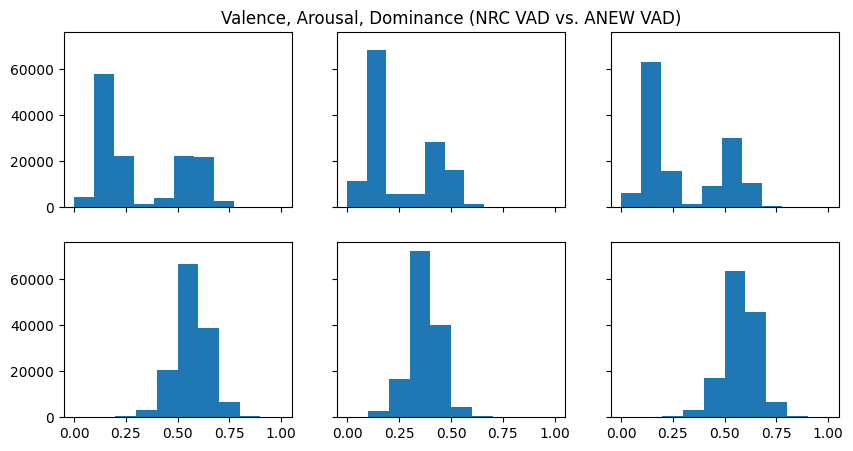

In [32]:
# Are the ANEW VADs normally distributed?!

fig, ax = plt.subplots(2, 3, figsize = (10, 5), sharex = True, sharey = True)

ax[0][0].hist(data_merged['Valence'])
ax[0][1].hist(data_merged['Arousal'])
ax[0][2].hist(data_merged['Dominance'])

ax[1][0].hist(data_merged['valence_anew_resc'])
ax[1][1].hist(data_merged['arousal_anew_resc'])
ax[1][2].hist(data_merged['dominance_anew_resc'])

ax[0][1].set_title('Valence, Arousal, Dominance (NRC VAD vs. ANEW VAD)')

plt.show()

***
#### ANEW - Code (Run as a seperate .py file)

In [2]:
#!/usr/bin/env python3

# anew VAD analysis

import csv
import sys
import os
import statistics
import time
import argparse
import numpy as np
from stanfordcorenlp import StanfordCoreNLP
from tqdm import tqdm
import time

import nltk
from nltk import tokenize
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem.wordnet import WordNetLemmatizer
# nltk.download('averaged_perceptron_tagger')
# nltk.download('wordnet')

print('libs loaded')

path = 'text_vad'
model = 'stanford-corenlp-4.5.7'
print(f'model: {path}/{model}')

nlp = StanfordCoreNLP(f'{path}/{model}')
lmtzr = WordNetLemmatizer()
stops = set(stopwords.words("english"))
#anew = "../lib/vad-nrc.csv"
anew = f"{path}/lib/EnglishShortened.csv"
avg_V = 5.06    # average V from ANEW dict
avg_A = 4.21
avg_D = 5.18

mode = 'mean'
input_file_name = input('Enter the input file name: ')
input_file = f'{path}/inputs/{input_file_name}'
input_dir = ''
output_dir = f'{path}/out/anew_' + mode
print(f'ouput_dir: {output_dir}')

# performs sentiment analysis on inputFile using the ANEW database, outputting results to a new CSV file in outputDir
def analyzefile(input_file, output_dir, mode):
    """
    Performs sentiment analysis on the text file given as input using the ANEW database.
    Outputs results to a new CSV file in output_dir.
    :param input_file: path of .txt file to analyze
    :param output_dir: path of directory to create new output file
    :param mode: determines how sentiment values for a sentence are computed (median or mean)
    :return:
    """
    output_file = os.path.join(output_dir, os.path.basename(input_file).rstrip('.txt') + ".csv") #"OutputAnewSentiment_" + 
    # make buffer for list of utterance
    utterances = []
    # read file into string
    with open(input_file, 'r', encoding = 'utf-8') as myfile:
        #for line in myfile.readlines():
            #utterance = tokenize.word_tokenize(line)
            #utterances = np.append(utterances, utterance)
            #utterances.append(utterance)
        
        # writing file
        i = 1 # to store sentence/line index
        # check each word in sentence/line for sentiment and write to output_file
        with open(output_file, 'w', newline='', encoding = 'utf-8') as csvfile:
            fieldnames = ['Sentence ID', 'Sentence', 'Valence', 'Arousal', 'Dominance', 'Sentiment Label',
                          'Average VAD', '# Words Found', 'Found Words', 'All Words']
            writer = csv.DictWriter(csvfile, delimiter=';', fieldnames=fieldnames)
            writer.writeheader()

            # analyze each sentence/line for sentiment
            for line in tqdm(myfile.readlines()):
                s = tokenize.word_tokenize(line.lower())
                #print("S" + str(i) +": " + s)
                all_words = []
                found_words = []
                total_words = 0
                v_list = []  # holds valence scores
                a_list = []  # holds arousal scores
                d_list = []  # holds dominance scores

                # search for each valid word's sentiment in ANEW
                words = nltk.pos_tag(s)
                for index, p in enumerate(words):
                    # don't process stops or words w/ punctuation
                    w = p[0]
                    pos = p[1]
                    if w in stops or not w.isalpha():
                        continue

                    # check for negation in 3 words before current word
                    j = index-1
                    neg = False
                    while j >= 0 and j >= index-3:
                        if words[j][0] == 'not' or words[j][0] == 'no' or words[j][0] == 'n\'t':
                            neg = True
                            break
                        j -= 1
    
                    # lemmatize word based on pos
                    if pos[0] == 'N' or pos[0] == 'V':
                        lemma = lmtzr.lemmatize(w, pos=pos[0].lower())
                    else:
                        lemma = w
    
                    all_words.append(lemma)
    
                    # search for lemmatized word in ANEW
                    with open(anew) as csvfile:
                        reader = csv.DictReader(csvfile)
                        for row in reader:
                            if row['Word'].casefold() == lemma.casefold():
                                if neg:
                                    found_words.append("neg-"+lemma)
                                else:
                                    found_words.append(lemma)
                                v = float(row['valence'])
                                a = float(row['arousal'])
                                d = float(row['dominance'])

                                if neg:
                                    # reverse polarity for this word
                                    v = 5 - (v - 5)
                                    a = 5 - (a - 5)
                                    d = 5 - (d - 5)

                                v_list.append(v)
                                a_list.append(a)
                                d_list.append(d)

                if len(found_words) == 0:  # no words found in ANEW for this sentence
                    writer.writerow({'Sentence ID': i,
                                     'Sentence': s,
                                     'Valence': np.nan,
                                     'Sentiment Label': np.nan,
                                     'Arousal': np.nan,
                                     'Dominance': np.nan,
                                     'Average VAD': np.nan,
                                     '# Words Found': 0,
                                     'Found Words': np.nan,
                                     'All Words': all_words
                                     })
                    i += 1
                else:  # output sentiment info for this sentence
                    # get values
                    if mode == 'median':
                        sentiment = statistics.median(v_list)
                        arousal = statistics.median(a_list)
                        dominance = statistics.median(d_list)
                    elif mode == 'mean':
                        sentiment = statistics.mean(v_list)
                        arousal = statistics.mean(a_list)
                        dominance = statistics.mean(d_list)
                    elif mode == 'mika':
                        # calculate valence
                        if statistics.mean(v_list) < avg_V:
                            sentiment = max(v_list) - avg_V
                        elif max(v_list) < avg_V:
                            sentiment = avg_V - min(v_list)
                        else:
                            sentiment = max(v_list) - min(v_list)
                        # calculate arousal
                        if statistics.mean(a_list) < avg_A:
                            arousal = max(a_list) - avg_A
                        elif max(a_list) < avg_A:
                            arousal = avg_A - min(a_list)
                        else:
                            arousal = max(a_list) - min(a_list)
                        # calculate dominance
                        if statistics.mean(d_list) < avg_D:
                            dominance = max(d_list) - avg_D
                        elif max(d_list) < avg_D:
                            dominance = avg_D - min(a_list)
                        else:
                            dominance = max(d_list) - min(d_list)
                    else:
                        raise Exception('Unknown mode')
                        
                     # set sentiment label
                    label = 'neutral'
                    if sentiment > 6:
                        label = 'positive'
                    elif sentiment < 4:
                        label = 'negative'

                    writer.writerow({'Sentence ID': i,
                                     'Sentence': s,
                                     'Valence': sentiment,
                                     'Arousal': arousal,
                                     'Dominance': dominance,
                                     'Average VAD': np.mean([sentiment, arousal, dominance]),
                                     'Sentiment Label': label,
                                     '# Words Found': ("%d out of %d" % (len(found_words), len(all_words))),
                                     'Found Words': found_words,
                                     'All Words': all_words
                                     })
                    i += 1


def main(input_file, input_dir, output_dir, mode):
    """
    Runs analyzefile on the appropriate files, provided that the input paths are valid.
    :param input_file:
    :param input_dir:
    :param output_dir:
    :param mode:
    :return:
    """

    if len(output_dir) < 0 or not os.path.exists(output_dir):  # empty output
        print('No output directory specified, or path does not exist')
        sys.exit(0)
    elif len(input_file) == 0 and len(input_dir)  == 0:  # empty input
        print('No input specified. Please give either a single file or a directory of files to analyze.')
        sys.exit(1)
    elif len(input_file) > 0:  # handle single file
        if os.path.exists(input_file):
            analyzefile(input_file, output_dir, mode)
        else:
            print('Input file "' + input_file + '" is invalid.')
            sys.exit(0)
    elif len(input_dir) > 0:  # handle directory
        if os.path.isdir(input_dir):
            directory = os.fsencode(input_dir)
            for file in os.listdir(directory):
                filename = os.path.join(input_dir, os.fsdecode(file))
                if filename.endswith(".txt"):
                    start_time = time.time()
                    print("Starting sentiment analysis of " + filename + "...")
                    analyzefile(filename, output_dir, mode)
                    print("Finished analyzing " + filename + " in " + str((time.time() - start_time)) + " seconds")
        else:
            print('Input directory "' + input_dir + '" is invalid.')
            sys.exit(0)

start = time.time()

if __name__ == '__main__':
    # get arguments below:
    input_file = input_file
    input_dir = input_dir #only for input directory
    mode = mode
    output_dir = output_dir
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    
    # run main with arguments above
    main(input_file, input_dir, output_dir, mode)

sys.exit(print(f'runtime: {(time.time() - start) / 60}min'))

libs loaded


SystemExit: 